# 2.0 Feature Engineering
## 2.3 Feature Selection Process

In [219]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler, minmax_scale  # Added minmax_scale import

data = pd.read_csv("data/training-selected/all/pose_data_augmented_z_res_0301.csv")

p_labels = data['label_encoded'].values
d_labels = data['difficulty'].values

features = pd.concat([data.iloc[:, 6:9], data.iloc[:, 39:93], data.iloc[:, 105:]], axis=1)
feature_names = features.columns

weights = pd.read_csv("feature_weights_20240311.csv")

weights_dict = {
    "logr": minmax_scale(weights['logr'].tolist()),
    "gini": minmax_scale(weights['gini'].tolist()),
    "permutation": minmax_scale(weights['permutation'].tolist()),
    "shap": minmax_scale(weights['shap'].tolist())
}

top_features = {}

for model_name, weights in weights_dict.items():
    # Use enumerate to get both indices and weights
    model_features_scores = sorted(enumerate(weights), key=lambda x: x[1], reverse=True)
    top_features_indices = [index for index, score in model_features_scores[:10]]
    top_features[model_name] = [feature_names[index] for index in top_features_indices]

print("Important features based on index:")
top_features

Important features based on index:


{'logr': ['landmark_00_y',
  'a_lft_hip_to_ankle',
  'landmark_21_y',
  'stomach_y',
  'landmark_28_y',
  'chest_y',
  'landmark_24_y',
  'landmark_12_y',
  'landmark_18_y',
  'a_lft_shoulder_to_wrist'],
 'gini': ['stomach_y',
  'hip_y',
  'chest_y',
  'landmark_00_y',
  'd_elbows',
  'd_wrists',
  'landmark_24_y',
  'd_rgt_shoulder_to_ankle',
  'd_ankles',
  'd_knees'],
 'permutation': ['a_rgt_hip_to_ankle',
  'a_rgt_shoulder_to_wrist',
  'd_knees',
  'a_lft_hip_to_ankle',
  'd_lft_shoulder_to_ankle',
  'd_ankles',
  'a_mid_hip_to_knees',
  'd_rgt_shoulder_to_ankle',
  'd_wrists',
  'a_lft_shoulder_to_wrist'],
 'shap': ['landmark_27_y',
  'landmark_00_y',
  'hip_y',
  'd_lft_shoulder_to_ankle',
  'landmark_24_y',
  'landmark_26_y',
  'a_rgt_hip_to_ankle',
  'a_mid_hip_to_knees',
  'landmark_14_y',
  'a_lft_hip_to_ankle']}

In [25]:
import shap
import pandas as pd
from sklearn.preprocessing import minmax_scale

# Augmented Dataset
data = pd.read_csv("data/training-selected/all/pose_data_augmented_z_res_0301.csv")
shap_weights = pd.read_csv("data/feature_weights_shap.csv")

# Pose Class Labels
p_labels = data['label_encoded'].values
# Difficulty Labels
d_labels = data['difficulty'].values
# All Features, except eye and mouth area
features1 = pd.concat([data.iloc[:, 6:9], data.iloc[:, 39:93], data.iloc[:, 114:]], axis=1)
feature_names = features1.columns

weights_dict = {
    "shap": minmax_scale(shap_weights['shap'].tolist()),
}

top_features_per_model = {}

for model_name, weights in weights_dict.items():
    model_features_scores = sorted(zip(shap_weights.index, weights), key=lambda x: x[1], reverse=True)
    top_features_indices = model_features_scores[:11]
    top_features_per_model[model_name] = [feature_names[index] for index, score in top_features_indices]

print("Important features based on index:")
top_features_per_model


Important features based on index:


{'shap': ['landmark_27_y',
  'landmark_00_y',
  'landmark_26_y',
  'landmark_12_y',
  'landmark_14_y',
  'landmark_23_y',
  'd_lft_shoulder_to_ankle',
  'a_rgt_hip_to_ankle',
  'a_mid_hip_to_knees',
  'd_nose_to_rgt_knee',
  'landmark_25_y']}

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


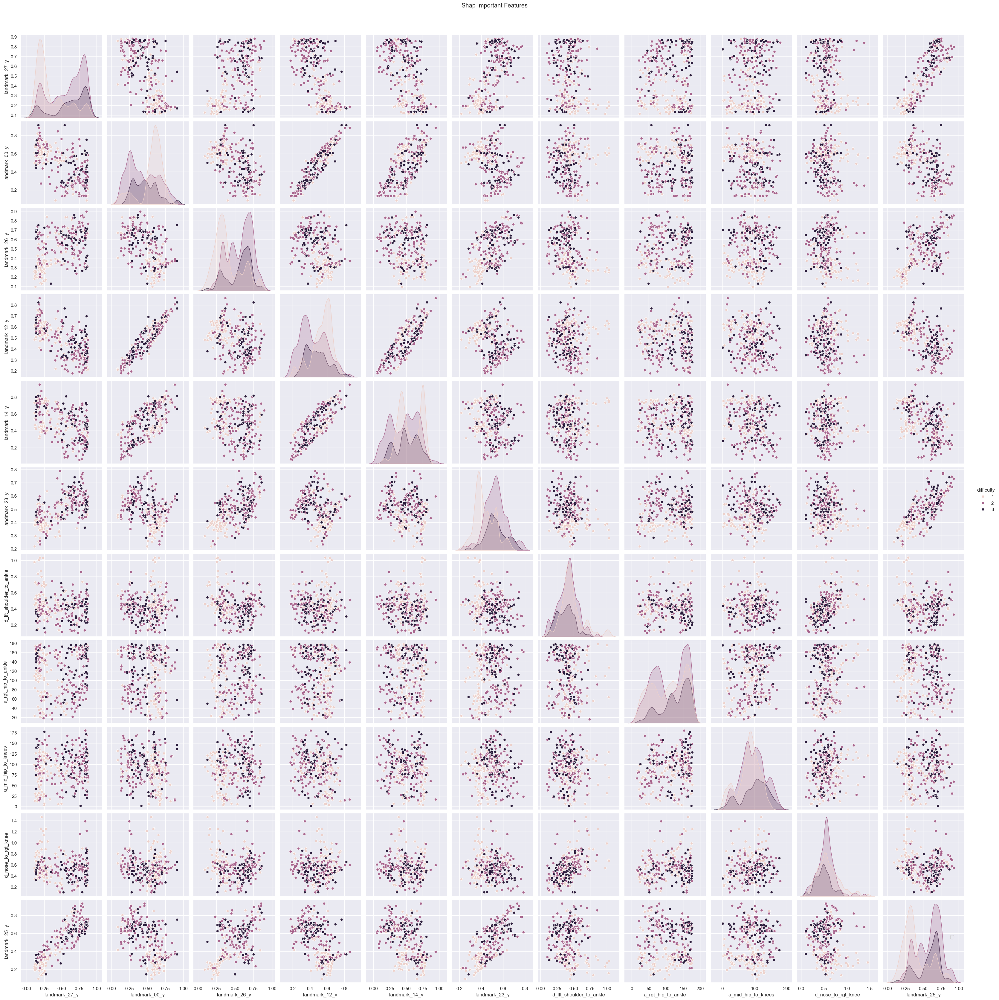

In [27]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
from sklearn.preprocessing import StandardScaler
from datetime import datetime

def pairplot_by_model(model_name, keywords=[]):
    data = pd.read_csv("data/training-selected/all/pose_data_augmented_z_res_0301.csv")
    
    if len(keywords) != 0:
        filtered_data = data[data['label'].str.contains('|'.join(keywords), na=False)]
        data = filtered_data
        
    features = top_features_per_model[model_name] + ['difficulty', 'label']
    sns.set_theme()
    g = sns.pairplot(data[features], hue='difficulty', height=3)
    plt.savefig(f"figures/pairplot_{model_name}_{datetime.now().strftime('%Y-%m-%d_%H-%M-%S')}.png")
    plt.suptitle(f"{model_name.capitalize()} Important Features", y=1.02)
    plt.legend(bbox_to_anchor=(0.9, 0.6))
    plt.show()

#["strong-hold","armpit-hold"]
input_keywords = []
pairplot_by_model("shap", input_keywords)

### Class Separability for all poses with "Armpit Hold"

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


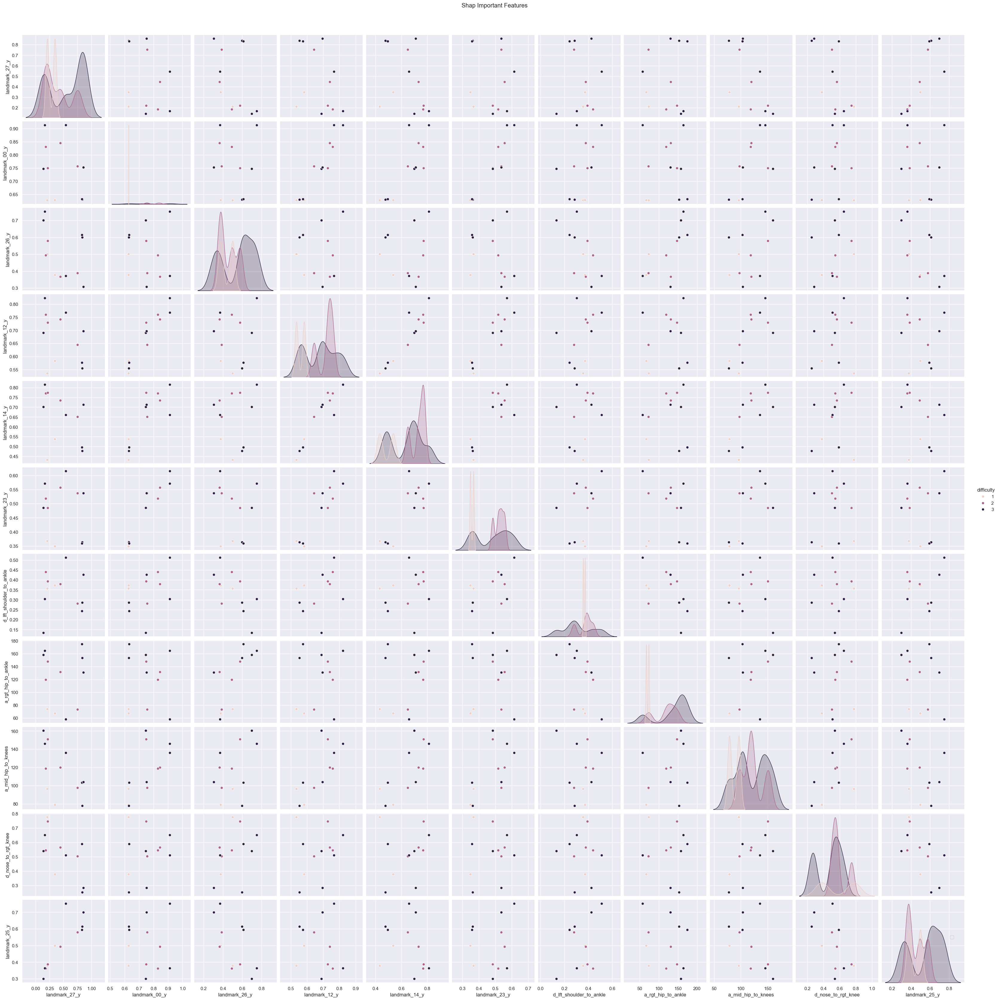

In [28]:
input_keywords = ["armpit-hold"]
pairplot_by_model("shap", input_keywords)

### Class Separability for all poses with "Split Grip"

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


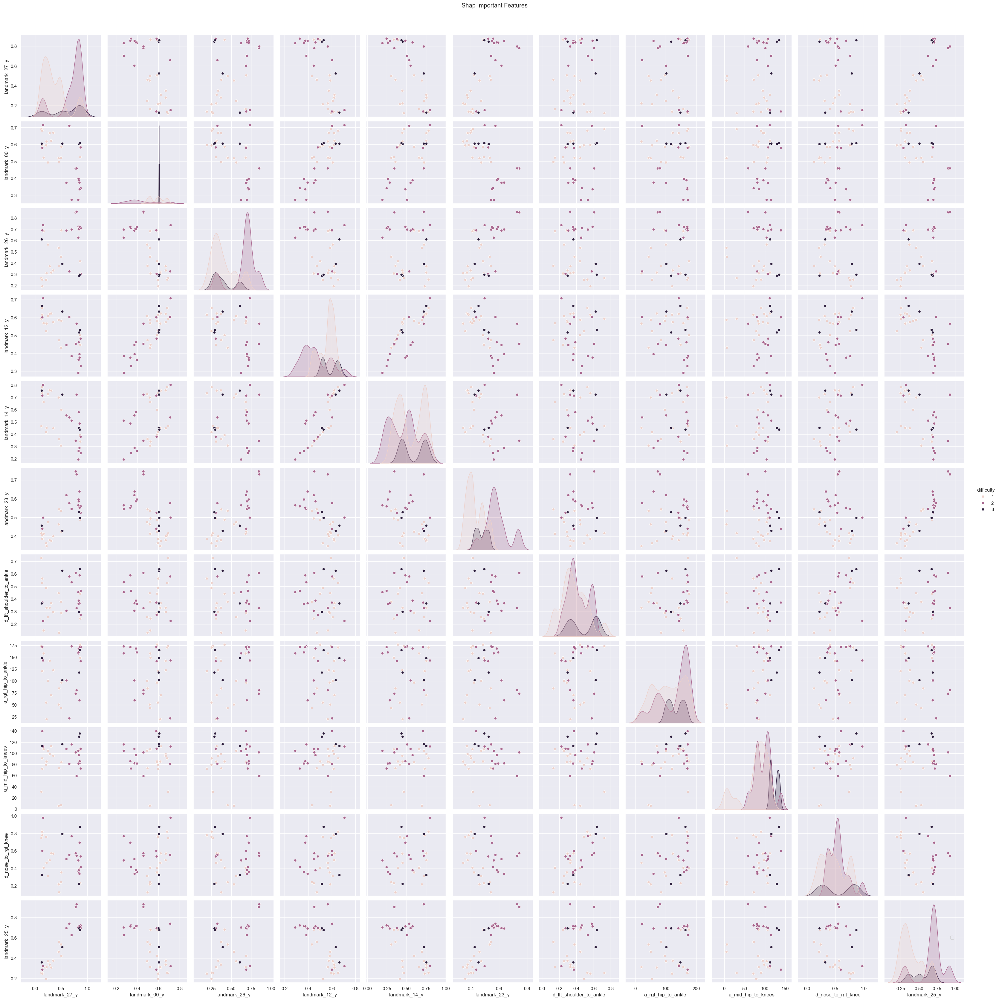

In [30]:
input_keywords = ["split-grip"]
pairplot_by_model("shap", input_keywords)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


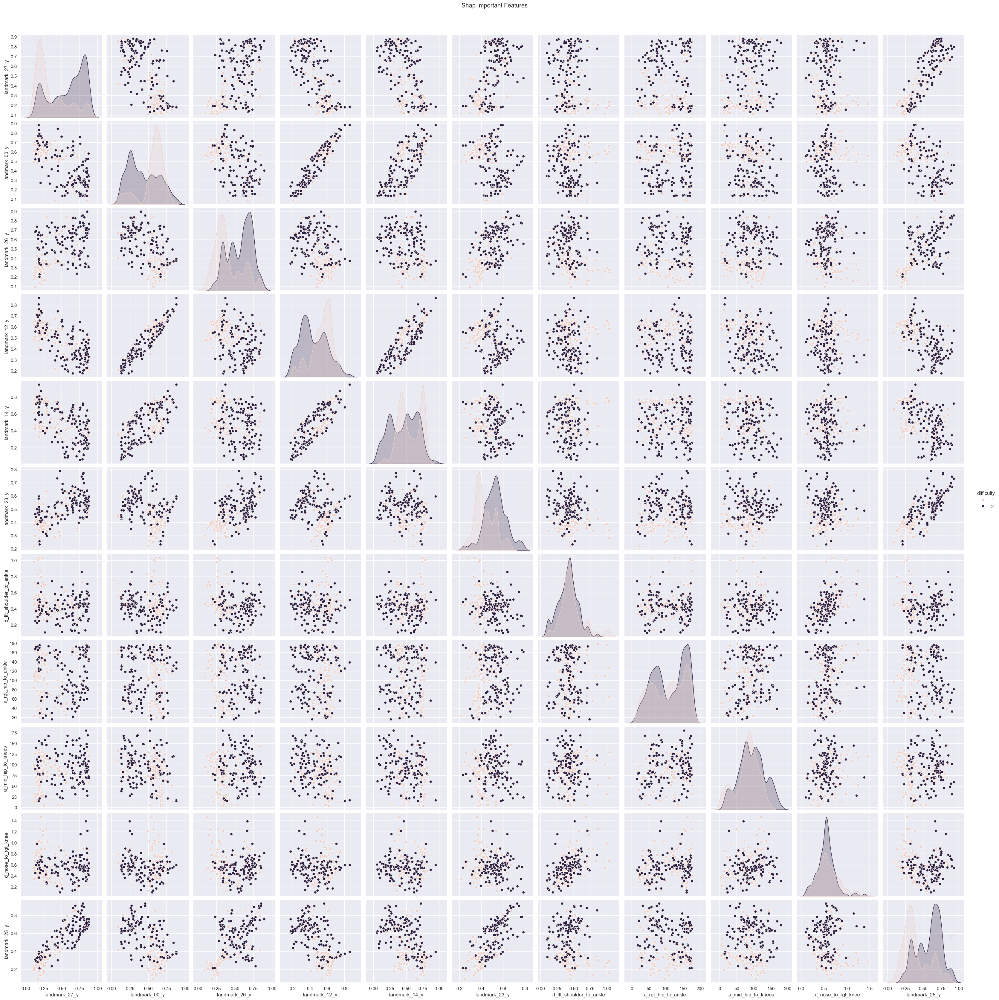

In [37]:
def pairplot_by_difficulty(model_name):
    data = pd.read_csv("data/training-selected/all/pose_data_augmented_z_res_0301.csv")
    filtered_data = data[data['difficulty'] < 3]
    selected_features = top_features_per_model[model_name] + ['difficulty', 'label']
    sns.set_theme()
    g = sns.pairplot(filtered_data[selected_features], hue='difficulty', height=3)
    plt.savefig(f"figures/pairplot_{model_name}_{datetime.now().strftime('%Y-%m-%d_%H-%M-%S')}.png")
    plt.suptitle(f"{model_name.capitalize()} Important Features", y=1.02)
    plt.legend(bbox_to_anchor=(0.9, 0.6))
    plt.show()

pairplot_by_difficulty("shap", diff_threshold=3)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


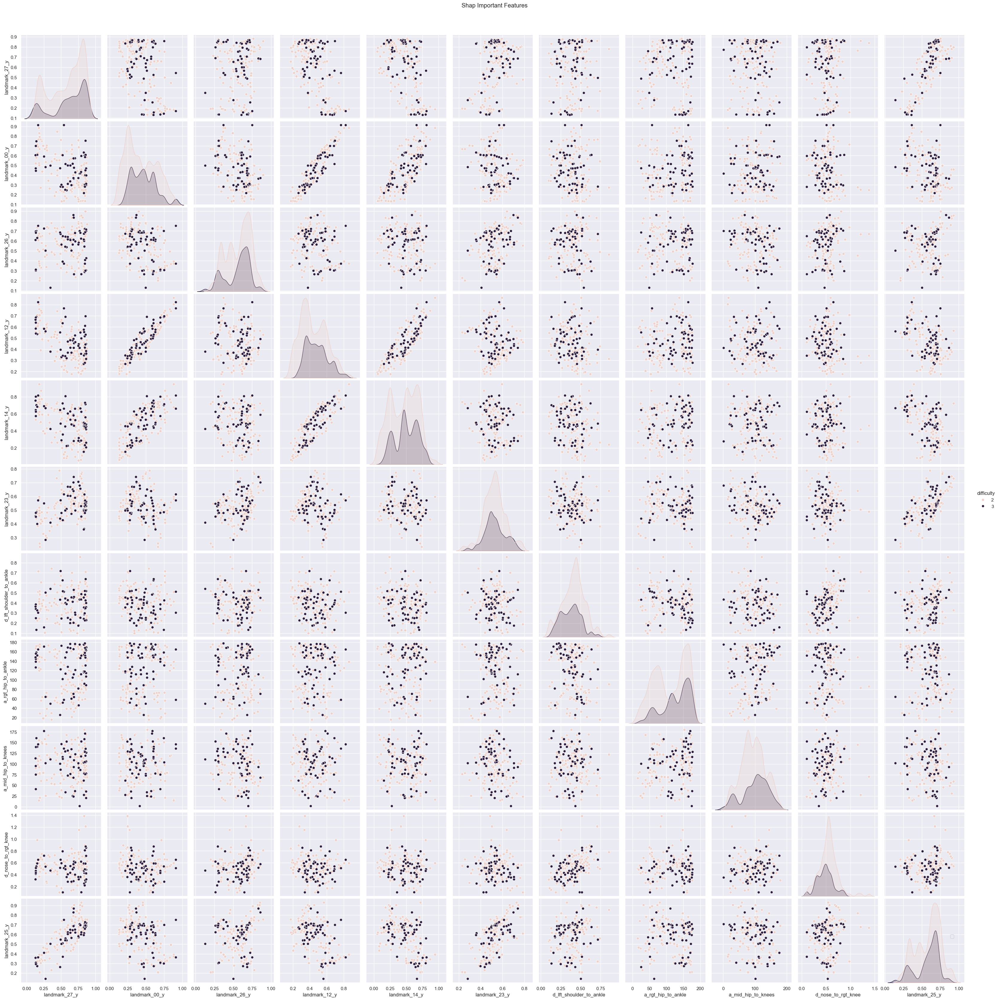

In [42]:
def pairplot_by_difficulty2(model_name):
    data = pd.read_csv("data/training-selected/all/pose_data_augmented_z_res_0301.csv")
    filtered_data = data[(data['difficulty'] == 2) | (data['difficulty'] == 3)]
    selected_features = top_features_per_model[model_name] + ['difficulty', 'label']
    sns.set_theme()
    g = sns.pairplot(filtered_data[selected_features], hue='difficulty', height=3)
    plt.savefig(f"figures/pairplot_{model_name}_{datetime.now().strftime('%Y-%m-%d_%H-%M-%S')}.png")
    plt.suptitle(f"{model_name.capitalize()} Important Features", y=1.02)
    plt.legend(bbox_to_anchor=(0.9, 0.6))
    plt.show()

pairplot_by_difficulty2("shap")

In [43]:
keywords = ['strong-hold','split-grip','handstand']
data = pd.read_csv("data/training-selected/all/pose_data_augmented_z_res_0301.csv")
filtered_data = data[data['label'].str.contains('|'.join(keywords), na=False)]
for keyword in keywords:
    filtered_data.loc[filtered_data['label'].str.contains(keyword, na=False), 'grip'] = keyword
    
filtered_data

/var/folders/8q/psx_9spx6sn4p06701_g30nh0000gn/T/ipykernel_38414/1432429482.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_data.loc[filtered_data['label'].str.contains(keyword, na=False), 'grip'] = keyword
/var/folders/8q/psx_9spx6sn4p06701_g30nh0000gn/T/ipykernel_38414/1432429482.py:5: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value 'strong-hold' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  filtered_data.loc[filtered_data['label'].str.contains(keyword, na=False), 'grip'] = keyword


,image_filename,pose_name,difficulty,label,label_encoded,theta,landmark_00_x,landmark_00_y,landmark_00_z,landmark_01_x,...,d_knees,d_ankles,a_nose_to_rgt_shoulder,a_nose_to_lft_shoulder,a_mid_hip_to_knees,a_lft_shoulder_to_wrist,a_lft_hip_to_ankle,a_rgt_shoulder_to_wrist,a_rgt_hip_to_ankle,grip
2736,split-grip-apprentice-lft.png,split-grip-apprentice-lft,1,split-grip-apprentice,38,0,0.303186,0.586195,-0.317912,0.304543,...,0.5884,0.5231,135.0963,44.9037,85.2223,153.6805,73.9126,108.8479,176.3806,split-grip
2737,split-grip-apprentice-lft.png,split-grip-apprentice-lft,1,split-grip-apprentice,38,10,0.353784,0.586195,-0.260434,0.349963,...,0.5884,0.5231,135.0963,44.9037,85.2223,153.6805,73.9126,108.8479,176.3806,split-grip
2738,split-grip-apprentice-lft.png,split-grip-apprentice-lft,1,split-grip-apprentice,38,20,0.393633,0.586195,-0.195044,0.384749,...,0.5884,0.5231,135.0963,44.9037,85.2223,153.6805,73.9126,108.8479,176.3806,split-grip
2739,split-grip-apprentice-lft.png,split-grip-apprentice-lft,1,split-grip-apprentice,38,30,0.421522,0.586195,-0.123727,0.407845,...,0.5884,0.5231,135.0963,44.9037,85.2223,153.6805,73.9126,108.8479,176.3806,split-grip
2740,split-grip-apprentice-lft.png,split-grip-apprentice-lft,1,split-grip-apprentice,38,40,0.436603,0.586195,-0.048651,0.418548,...,0.5884,0.5231,135.0963,44.9037,85.2223,153.6805,73.9126,108.8479,176.3806,split-grip
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10219,strong-hold-side-split-rgt.png,strong-hold-side-split-rgt,3,strong-hold-side-split,140,310,0.113107,0.444561,-0.761474,0.140032,...,0.4344,0.7478,47.5918,132.4082,139.5484,141.6383,156.0463,152.2347,155.7035,strong-hold
10220,strong-hold-side-split-rgt.png,strong-hold-side-split-rgt,3,strong-hold-side-split,140,320,0.243617,0.444561,-0.730265,0.269601,...,0.4344,0.7478,47.5918,132.4082,139.5484,141.6383,156.0463,152.2347,155.7035,strong-hold
10221,strong-hold-side-split-rgt.png,strong-hold-side-split-rgt,3,strong-hold-side-split,140,330,0.366725,0.444561,-0.676867,0.390978,...,0.4344,0.7478,47.5918,132.4082,139.5484,141.6383,156.0463,152.2347,155.7035,strong-hold
10222,strong-hold-side-split-rgt.png,strong-hold-side-split-rgt,3,strong-hold-side-split,140,340,0.478690,0.444561,-0.602902,0.500475,...,0.4344,0.7478,47.5918,132.4082,139.5484,141.6383,156.0463,152.2347,155.7035,strong-hold


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


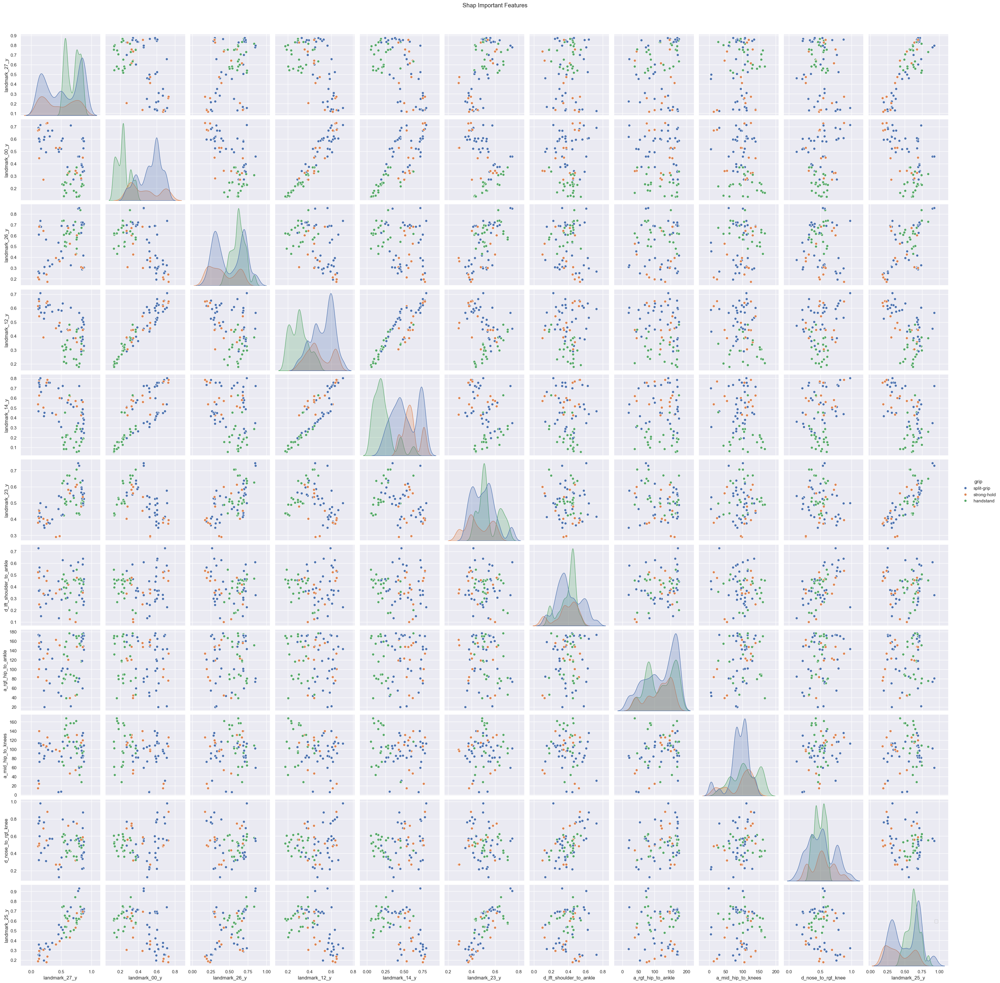

In [44]:
selected_features = top_features_per_model[model_name] + ['grip', 'label']
sns.set_theme()
g = sns.pairplot(filtered_data[selected_features], hue='grip', height=3)
plt.savefig(f"figures/pairplot_shap_{datetime.now().strftime('%Y-%m-%d_%H-%M-%S')}.png")
plt.suptitle(f"Shap Important Features", y=1.02)
plt.legend(bbox_to_anchor=(0.9, 0.6))
plt.show()

In [191]:
from sklearn.decomposition import PCA
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
import plotly.graph_objects as go
import plotly.express as px

# Augmented Dataset
data = pd.read_csv("data/training-selected/all/pose_data_augmented_z_res_0301.csv")

#Filter Words
#keywords = ['handstand','butterfly']
#filtered_data = data[data['label'].str.contains('|'.join(keywords), na=False)]
#data = filtered_data

# Extract Labels
p_labels = data['label_encoded'].values
d_labels = data['difficulty'].values

# All Features, except eye and mouth area
features1 = pd.concat([data.iloc[:, 6:9], data.iloc[:, 39:93], data.iloc[:, 105:]], axis=1)
shap_features = ['landmark_27_y','landmark_00_y','landmark_26_y','landmark_12_y','landmark_14_y','landmark_23_y','d_lft_shoulder_to_ankle','a_rgt_hip_to_ankle','a_mid_hip_to_knees','d_nose_to_rgt_knee','landmark_25_y']

features_selection1 = features1[shap_features]
feature_names = features_selection1.columns

features_selection1

,landmark_27_y,landmark_00_y,landmark_26_y,landmark_12_y,landmark_14_y,landmark_23_y,d_lft_shoulder_to_ankle,a_rgt_hip_to_ankle,a_mid_hip_to_knees,d_nose_to_rgt_knee,landmark_25_y
0,0.210703,0.627645,0.500683,0.535374,0.432449,0.367684,0.3566,73.6329,96.2236,0.7763,0.377967
1,0.210703,0.627645,0.500683,0.535374,0.432449,0.367684,0.3566,73.6329,96.2236,0.7763,0.377967
2,0.210703,0.627645,0.500683,0.535374,0.432449,0.367684,0.3566,73.6329,96.2236,0.7763,0.377967
3,0.210703,0.627645,0.500683,0.535374,0.432449,0.367684,0.3566,73.6329,96.2236,0.7763,0.377967
4,0.210703,0.627645,0.500683,0.535374,0.432449,0.367684,0.3566,73.6329,96.2236,0.7763,0.377967
...,...,...,...,...,...,...,...,...,...,...,...
10219,0.134470,0.444561,0.681945,0.541557,0.624993,0.451478,0.2497,155.7035,139.5484,0.5131,0.293465
10220,0.134470,0.444561,0.681945,0.541557,0.624993,0.451478,0.2497,155.7035,139.5484,0.5131,0.293465
10221,0.134470,0.444561,0.681945,0.541557,0.624993,0.451478,0.2497,155.7035,139.5484,0.5131,0.293465
10222,0.134470,0.444561,0.681945,0.541557,0.624993,0.451478,0.2497,155.7035,139.5484,0.5131,0.293465


## LDA

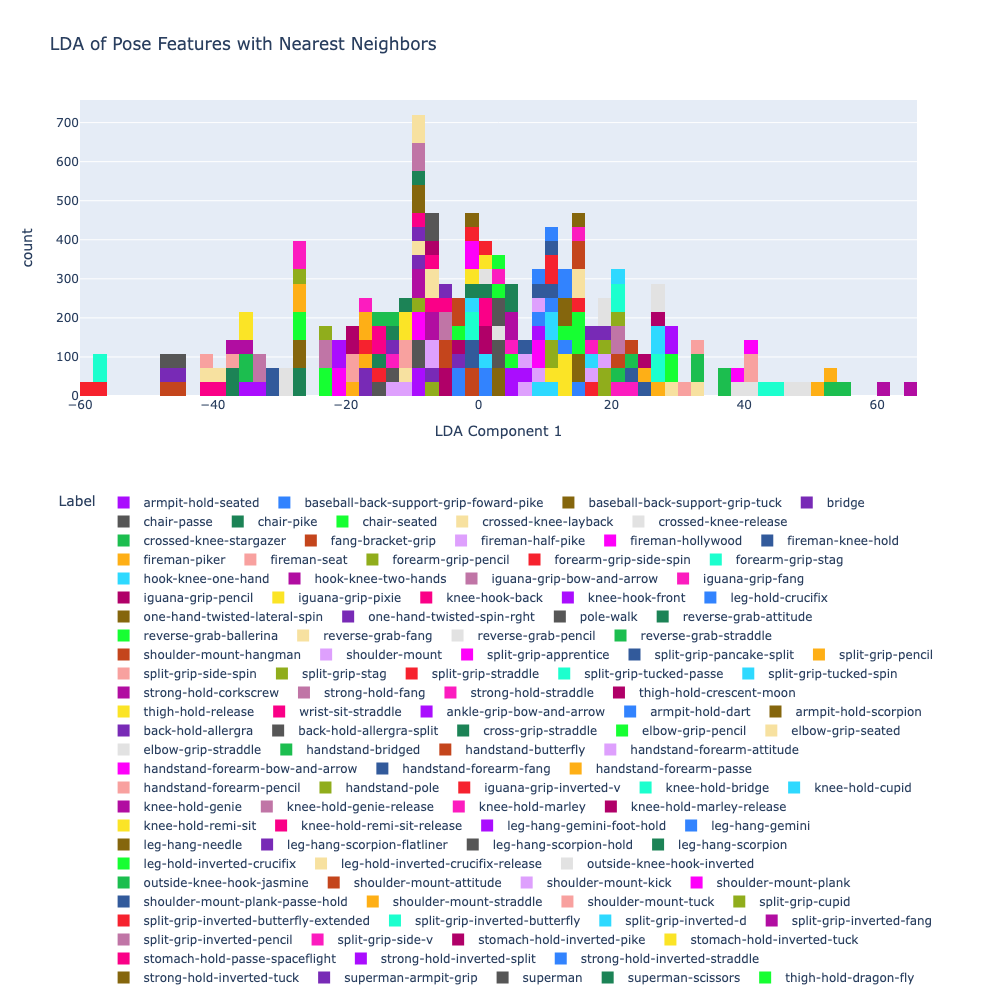

In [204]:
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.preprocessing import StandardScaler
import plotly.express as px
import pandas as pd
import numpy as np

# Standardize features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(features_selection1)

n_components = 1
lda = LinearDiscriminantAnalysis(n_components=n_components)
X_lda = lda.fit_transform(X_scaled, y)

# Make sure the color palette is large enough for all classes
unique_labels = np.unique(pose_classes)
palette = px.colors.qualitative.Alphabet
# Extend the palette if there are not enough colors
color_discrete_sequence = (palette * (len(unique_labels) // len(palette) + 1))[:len(unique_labels)]

df_vis = pd.DataFrame(X_lda, columns=[f'LDA{i+1}' for i in range(n_components)])
df_vis['Label'] = pose_classes

# Create figures for either 1 or 2 LDA components
if n_components == 1:
    fig = px.histogram(df_vis, x='LDA1', color='Label',
                       title="LDA of Pose Features with Nearest Neighbors",
                       color_discrete_sequence=color_discrete_sequence)
    # Adjust for histogram
    fig.update_layout(
        xaxis_title="LDA Component 1",
        xaxis={'categoryorder':'total descending'}
    )
    fig.update_xaxes(categoryorder='total descending')
    
elif n_components == 2:
    fig = px.scatter(df_vis, x='LDA1', y='LDA2', color='Label',
                     title="LDA of Pose Features with Nearest Neighbors",
                     color_discrete_sequence=color_discrete_sequence)
    # Adjust for scatter plot
    fig.update_layout(
        xaxis_title="LDA Component 1",
        yaxis_title="LDA Component 2",
    )

elif n_components == 3:
    df_vis = pd.DataFrame(X_lda, columns=['LDA1', 'LDA2', 'LDA3'])
    df_vis['Label'] = pose_classes
    fig = px.scatter_3d(df_vis, x='LDA1', y='LDA2', z='LDA3', color='Label',
                        title="3D LDA of Pose Features with Nearest Neighbors",
                        color_discrete_sequence=color_discrete_sequence)
    # Adjust for 3D scatter plot
    fig.update_layout(
        scene=dict(
            xaxis_title='LDA Component 1',
            yaxis_title='LDA Component 2',
            zaxis_title='LDA Component 3'
        ),
    )
else:
    print("only 1,2 or 3")

# Common layout updates
fig.update_layout(
    legend=dict(yanchor='bottom', xanchor='center', y=-2, x=0.5, orientation='h'),
    height=1000,
    width=1000,
)

# Show the plot
fig.show()

In [205]:
from sklearn.preprocessing import MinMaxScaler

class_means = df_vis.groupby('Label')['LDA1'].mean().reset_index()

# 2. Normalize the values based on min and max values
#scaler = MinMaxScaler()
#class_means['LDA1_normalized'] = scaler.fit_transform(class_means[['LDA1']])

knn = KNeighborsClassifier(n_neighbors=20, metric='euclidean', weights='distance')
knn.fit(class_means[['LDA1']], class_means['Label'])

KNeighborsClassifier(metric='euclidean', n_neighbors=20, weights='distance')

In [206]:
class_means

,Label,LDA1
0,ankle-grip-bow-and-arrow,5.543133
1,armpit-hold-dart,14.208088
2,armpit-hold-forward-pike,14.268542
3,armpit-hold-front-split,17.714337
4,armpit-hold-passe,39.940121
...,...,...
136,thigh-hold-dragonfly-crossed,14.779576
137,thigh-hold-release,12.562318
138,tuck-hold,26.551379
139,twisted-grip-inverted-straddle,53.697522


In [207]:
distances, indices = knn.kneighbors(class_means[['LDA1']].values)

# Function to get closest class labels excluding the class itself
def get_closest_classes(row_idx, indices, labels, num_closest=3):
    closest_classes = []
    for neighbor_idx in indices[row_idx][1:num_closest+1]:  # Skip the first one since it's the class itself
        closest_classes.append(labels[neighbor_idx])
    return closest_classes

# Apply this function to each class mean to find its closest classes
class_means['Closest Classes'] = [get_closest_classes(i, indices, class_means['Label'].values) for i in range(len(class_means))]

class_means[['Label', 'Closest Classes']]

/usr/local/lib/python3.11/site-packages/sklearn/base.py:465: UserWarning:

X does not have valid feature names, but KNeighborsClassifier was fitted with feature names



,Label,Closest Classes
0,ankle-grip-bow-and-arrow,"[handstand-onehand, split-grip-backward-split,..."
1,armpit-hold-dart,"[armpit-hold-forward-pike, elbow-grip-pencil, ..."
2,armpit-hold-forward-pike,"[armpit-hold-dart, elbow-grip-pencil, armpit-h..."
3,armpit-hold-front-split,"[shoulder-mount-princess-grip-straddle, handst..."
4,armpit-hold-passe,"[crossed-knee-release, shoulder-mount-tuck, ha..."
...,...,...
136,thigh-hold-dragonfly-crossed,"[armpit-hold-scorpion, elbow-grip-pencil, armp..."
137,thigh-hold-release,"[iguana-grip-pixie, leg-hang-needle, strong-ho..."
138,tuck-hold,"[split-grip-inverted-d, split-grip-inverted-bu..."
139,twisted-grip-inverted-straddle,"[elbow-grip-fang, outside-knee-hook-inverted, ..."


In [208]:
class_means.to_csv("knn_closes_classes2.csv", index=False)

## Results

1. Overall, all feature pairs do not have clear class boundaries based on their assigned difficulty level. Class separability between 2 and 3 (intermediate and advanced) where class 1 is found in between. This could mean that those feature combinations might not be strong predictors for distinguishing between classes on their own or might require more complex decision boundaries than linear separability.